In [2]:
from __future__ import absolute_import, division, print_function, unicode_literals
import tensorflow as tf

import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd

print(tf.__version__)

mpl.rcParams['figure.figsize'] = (8, 6)
mpl.rcParams['axes.grid'] = False

2.0.0


In [3]:
zip_path = tf.keras.utils.get_file(
    origin='https://storage.googleapis.com/tensorflow/tf-keras-datasets/jena_climate_2009_2016.csv.zip',
    fname='jena_climate_2009_2016.csv.zip',
    extract=True)
csv_path, _ = os.path.splitext(zip_path)

In [4]:
df = pd.read_csv(csv_path)
df.head()

,Date Time,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
0,01.01.2009 00:10:00,996.52,-8.02,265.40,-8.90,93.3,3.33,3.11,0.22,1.94,3.12,1307.75,1.03,1.75,152.3
1,01.01.2009 00:20:00,996.57,-8.41,265.01,-9.28,93.4,3.23,3.02,0.21,1.89,3.03,1309.80,0.72,1.50,136.1
2,01.01.2009 00:30:00,996.53,-8.51,264.91,-9.31,93.9,3.21,3.01,0.20,1.88,3.02,1310.24,0.19,0.63,171.6
3,01.01.2009 00:40:00,996.51,-8.31,265.12,-9.07,94.2,3.26,3.07,0.19,1.92,3.08,1309.19,0.34,0.50,198.0
4,01.01.2009 00:50:00,996.51,-8.27,265.15,-9.04,94.1,3.27,3.08,0.19,1.92,3.09,1309.00,0.32,0.63,214.3


In [5]:
len(df.values)

420551

In [6]:
def univariate_data(dataset, start_index, end_index, history_size, target_size):
  data = []
  labels = []

  start_index = start_index + history_size
  if end_index is None:
    end_index = len(dataset) - target_size

  print(range(start_index, end_index))

  for i in range(start_index, end_index):
    indices = range(i-history_size, i)
    # Reshape data from (history_size,) to (history_size, 1)
    data.append(np.reshape(dataset[indices], (history_size, 1)))
    labels.append(dataset[i+target_size])
  return np.array(data), np.array(labels)

In [7]:
TRAIN_SPLIT = 300000
tf.random.set_seed(13)

In [8]:
uni_data = df['T (degC)']
uni_data.index = df['Date Time']
uni_data.head()

Date Time
01.01.2009 00:10:00   -8.02
01.01.2009 00:20:00   -8.41
01.01.2009 00:30:00   -8.51
01.01.2009 00:40:00   -8.31
01.01.2009 00:50:00   -8.27
Name: T (degC), dtype: float64

array([<matplotlib.axes._subplots.AxesSubplot object at 0x000002602E56AE88>],
      dtype=object)

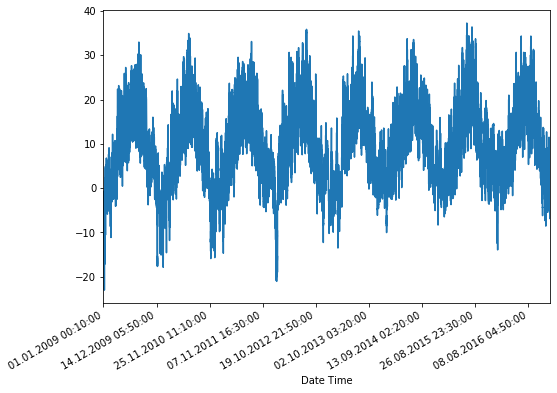

In [9]:
uni_data.plot(subplots=True)

In [10]:
print(uni_data)
uni_data = uni_data.values

Date Time
01.01.2009 00:10:00   -8.02
01.01.2009 00:20:00   -8.41
01.01.2009 00:30:00   -8.51
01.01.2009 00:40:00   -8.31
01.01.2009 00:50:00   -8.27
                       ... 
31.12.2016 23:20:00   -4.05
31.12.2016 23:30:00   -3.35
31.12.2016 23:40:00   -3.16
31.12.2016 23:50:00   -4.23
01.01.2017 00:00:00   -4.82
Name: T (degC), Length: 420551, dtype: float64


In [11]:
print(uni_data)

[-8.02 -8.41 -8.51 ... -3.16 -4.23 -4.82]


In [12]:
uni_train_mean = uni_data[:TRAIN_SPLIT].mean()
uni_train_std = uni_data[:TRAIN_SPLIT].std()

uni_data = (uni_data-uni_train_mean)/uni_train_std

In [13]:
print(len(uni_data))

420551


In [14]:
univariate_past_history = 20
univariate_future_target = 0

x_train_uni, y_train_uni = univariate_data(uni_data, 0, TRAIN_SPLIT,
                                           univariate_past_history,
                                           univariate_future_target)

range(20, 300000)


In [15]:
x_val_uni, y_val_uni = univariate_data(uni_data, TRAIN_SPLIT, None,
                                       univariate_past_history,
                                       univariate_future_target)

range(300020, 420551)


In [16]:
print ('Single window of past history')
print (x_train_uni[0])
print ('\n Target temperature to predict')
print (y_train_uni[0])

Single window of past history
[[-1.99766294]
 [-2.04281897]
 [-2.05439744]
 [-2.0312405 ]
 [-2.02660912]
 [-2.00113649]
 [-1.95134907]
 [-1.95134907]
 [-1.98492663]
 [-2.04513467]
 [-2.08334362]
 [-2.09723778]
 [-2.09376424]
 [-2.09144854]
 [-2.07176515]
 [-2.07176515]
 [-2.07639653]
 [-2.08913285]
 [-2.09260639]
 [-2.10418486]]

 Target temperature to predict
-2.1041848598100876


In [17]:
def create_time_steps(length):
  time_steps = []
  for i in range(-length, 0, 1):
    time_steps.append(i)
  return time_steps

In [18]:
def show_plot(plot_data, delta, title):
  labels = ['History', 'True Future', 'Model Prediction']
  marker = ['.-', 'rx', 'go']
  time_steps = create_time_steps(plot_data[0].shape[0])
  if delta:
    future = delta
  else:
    future = 0

  plt.title(title)
  for i, x in enumerate(plot_data):
    if i:
      plt.plot(future, plot_data[i], marker[i], markersize=10,
               label=labels[i])
    else:
      plt.plot(time_steps, plot_data[i].flatten(), marker[i], label=labels[i])
  plt.legend()
  plt.xlim([time_steps[0], (future+5)*2])
  plt.xlabel('Time-Step')
  return plt

In [19]:
o = [x_train_uni[0], y_train_uni[0]]
for i, x in enumerate(o):
    print(i, x)
print(enumerate(o))

0 [[-1.99766294]
 [-2.04281897]
 [-2.05439744]
 [-2.0312405 ]
 [-2.02660912]
 [-2.00113649]
 [-1.95134907]
 [-1.95134907]
 [-1.98492663]
 [-2.04513467]
 [-2.08334362]
 [-2.09723778]
 [-2.09376424]
 [-2.09144854]
 [-2.07176515]
 [-2.07176515]
 [-2.07639653]
 [-2.08913285]
 [-2.09260639]
 [-2.10418486]]
1 -2.1041848598100876


<module 'matplotlib.pyplot' from 'd:\\workspace\\magrss\\tf\\.venv\\lib\\site-packages\\matplotlib\\pyplot.py'>

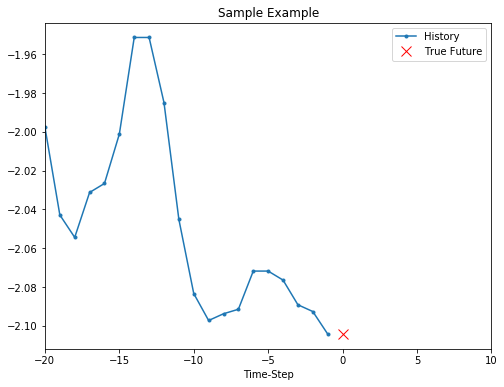

In [20]:
show_plot([x_train_uni[0], y_train_uni[0]], 0, 'Sample Example')

In [21]:
def baseline(history):
  return np.mean(history)

<module 'matplotlib.pyplot' from 'd:\\workspace\\magrss\\tf\\.venv\\lib\\site-packages\\matplotlib\\pyplot.py'>

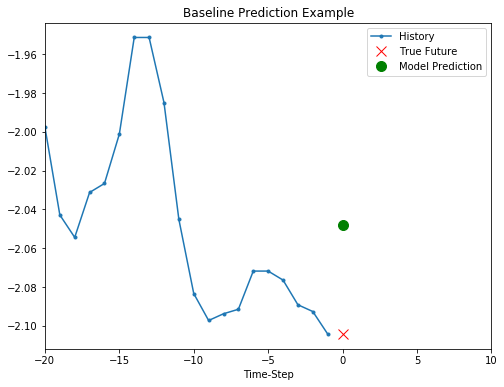

In [22]:
show_plot([x_train_uni[0], y_train_uni[0], baseline(x_train_uni[0])], 0,
           'Baseline Prediction Example')

In [23]:
BATCH_SIZE = 256
BUFFER_SIZE = 10000

train_univariate = tf.data.Dataset.from_tensor_slices((x_train_uni, y_train_uni))
train_univariate = train_univariate.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()

val_univariate = tf.data.Dataset.from_tensor_slices((x_val_uni, y_val_uni))
val_univariate = val_univariate.batch(BATCH_SIZE).repeat()

In [24]:
simple_lstm_model = tf.keras.models.Sequential([
    tf.keras.layers.LSTM(8, input_shape=x_train_uni.shape[-2:]),
    tf.keras.layers.Dense(1)
])

metrics=['accuracy', 'binary_crossentropy']

simple_lstm_model.compile(optimizer='adam', loss='mae')

In [25]:
print(x_train_uni.shape)
print(x_train_uni.shape[-2:])
print(x_train_uni.shape[0] // 256)

(299980, 20, 1)
(20, 1)
1171


In [26]:
for x, y in val_univariate.take(1):
    print(x, y)
    print(simple_lstm_model.predict(x).shape)

tf.Tensor(
[[[0.642228  ]
  [0.63643877]
  [0.63643877]
  ...
  [0.60401906]
  [0.60054552]
  [0.60054552]]

 [[0.63643877]
  [0.63643877]
  [0.63643877]
  ...
  [0.60054552]
  [0.60054552]
  [0.59938767]]

 [[0.63643877]
  [0.63643877]
  [0.63643877]
  ...
  [0.60054552]
  [0.59938767]
  [0.59938767]]

 ...

 [[0.6445437 ]
  [0.6445437 ]
  [0.64801724]
  ...
  [0.65264863]
  [0.65264863]
  [0.65264863]]

 [[0.6445437 ]
  [0.64801724]
  [0.6445437 ]
  ...
  [0.65264863]
  [0.65264863]
  [0.65264863]]

 [[0.64801724]
  [0.6445437 ]
  [0.65149078]
  ...
  [0.65264863]
  [0.65264863]
  [0.65264863]]], shape=(256, 20, 1), dtype=float64) tf.Tensor(
[0.59938767 0.59938767 0.59938767 0.59822982 0.59822982 0.58896705
 0.58317781 0.58317781 0.58317781 0.57970427 0.57159934 0.56696795
 0.5681258  0.56928365 0.5704415  0.57391504 0.57623073 0.57738858
 0.58317781 0.58896705 0.58665135 0.59359843 0.60286121 0.59012489
 0.59475628 0.60286121 0.60865044 0.61328183 0.62254461 0.63528092
 0.64338585 0

In [ ]:
EVALUATION_INTERVAL = 200
EPOCHS = 10
EVALUATION_INTERVAL = x_train_uni.shape[0] // BATCH_SIZE
EVALUATIN_INTERVAL = 2000
simple_lstm_model.fit(train_univariate, epochs=EPOCHS,
                      steps_per_epoch=EVALUATION_INTERVAL,
                      validation_data=val_univariate, validation_steps=500)

In [ ]:
for x, y in val_univariate.take(3):
  plot = show_plot([x[0].numpy(), y[0].numpy(),
                    simple_lstm_model.predict(x)[0]], 0, 'Simple LSTM model')
  plot.show()

In [27]:
features_considered = ['p (mbar)', 'T (degC)', 'rho (g/m**3)']
features = df[features_considered]
features.index = df['Date Time']
features.head()

,p (mbar),T (degC),rho (g/m**3)
Date Time,,,
01.01.2009 00:10:00,996.52,-8.02,1307.75
01.01.2009 00:20:00,996.57,-8.41,1309.80
01.01.2009 00:30:00,996.53,-8.51,1310.24
01.01.2009 00:40:00,996.51,-8.31,1309.19
01.01.2009 00:50:00,996.51,-8.27,1309.00


array([<matplotlib.axes._subplots.AxesSubplot object at 0x000002604CBE0A48>,
      dtype=object)

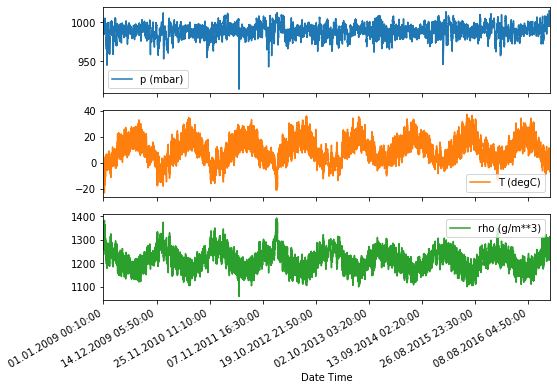

In [28]:
features.plot(subplots=True)

In [29]:
dataset = features.values
data_mean = dataset[:TRAIN_SPLIT].mean(axis=0)
data_std = dataset[:TRAIN_SPLIT].std(axis=0)
dataset = (dataset-data_mean)/data_std

In [30]:
print(dataset)

[[ 0.95547359 -1.99766294  2.2350791 ]
 [ 0.96154485 -2.04281897  2.28524007]
 [ 0.95668784 -2.05439744  2.29600633]
 ...
 [ 1.35617678 -1.43494935  1.76136375]
 [ 1.35496252 -1.55883897  1.88786728]
 [ 1.35617678 -1.62715193  1.95686921]]


In [31]:
print(dataset[:, 1])

[-1.99766294 -2.04281897 -2.05439744 ... -1.43494935 -1.55883897
 -1.62715193]


In [32]:
def multivariate_data(dataset, target, start_index, end_index, history_size,
                      target_size, step, single_step=False):
  data = []
  labels = []

  start_index = start_index + history_size
  if end_index is None:
    end_index = len(dataset) - target_size

  for i in range(start_index, end_index):
    indices = range(i-history_size, i, step)
    data.append(dataset[indices])

    if single_step:
      labels.append(target[i+target_size])
    else:
      labels.append(target[i:i+target_size])

  return np.array(data), np.array(labels)

In [33]:
past_history = 720
future_target = 72
STEP = 6

x_train_single, y_train_single = multivariate_data(dataset, dataset[:, 1], 0,
                                                   TRAIN_SPLIT, past_history,
                                                   future_target, STEP,
                                                   single_step=True)
x_val_single, y_val_single = multivariate_data(dataset, dataset[:, 1],
                                               TRAIN_SPLIT, None, past_history,
                                               future_target, STEP,
                                               single_step=True)

In [34]:
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
x_train_single_ts = TimeseriesGenerator(data=dataset, targets=dataset[:, 1], 
                                        start_index=0, end_index=TRAIN_SPLIT,
                                        length=past_history, sampling_rate=STEP,
                                        stride=future_target)
x, y = x_train_single_ts[0]

In [35]:
print(x_train_single[0])

[[ 0.95547359 -1.99766294  2.2350791 ]
 [ 0.95304508 -1.95134907  2.18442875]
 [ 0.96883036 -2.09376424  2.34176293]
 [ 0.99797241 -2.09260639  2.34812481]
 [ 1.01982895 -2.13776242  2.40317953]
 [ 1.06597053 -2.18870768  2.46997927]
 [ 1.11211211 -2.17944491  2.47218146]
 [ 1.1958955  -2.07755438  2.38482796]
 [ 1.28939291 -2.01155711  2.33858199]
 [ 1.35253402 -1.96176969  2.3026129 ]
 [ 1.43024615 -1.8830361   2.2389941 ]
 [ 1.47638773 -1.93513921  2.30750665]
 [ 1.40353261 -1.85293208  2.20033345]
 [ 1.37439056 -1.74409447  2.07921305]
 [ 1.35496252 -1.74525232  2.07407461]
 [ 1.37560481 -1.70935906  2.04128646]
 [ 1.38410457 -1.68388643  2.01632831]
 [ 1.3986756  -1.6977806   2.03565864]
 [ 1.39381859 -1.66651873  2.00164705]
 [ 1.41446088 -1.63641471  1.97448672]
 [ 1.41081812 -1.63988825  1.97815704]
 [ 1.4011041  -1.62946763  1.96323109]
 [ 1.3683193  -1.57968021  1.90254854]
 [ 1.35374827 -1.59010083  1.90964449]
 [ 1.32339197 -1.6016793   1.91282543]
 [ 1.29424992 -1.57736452

In [36]:
print(x[1])

[[ 1.40353261 -1.85293208  2.20033345]
 [ 1.37439056 -1.74409447  2.07921305]
 [ 1.35496252 -1.74525232  2.07407461]
 [ 1.37560481 -1.70935906  2.04128646]
 [ 1.38410457 -1.68388643  2.01632831]
 [ 1.3986756  -1.6977806   2.03565864]
 [ 1.39381859 -1.66651873  2.00164705]
 [ 1.41446088 -1.63641471  1.97448672]
 [ 1.41081812 -1.63988825  1.97815704]
 [ 1.4011041  -1.62946763  1.96323109]
 [ 1.3683193  -1.57968021  1.90254854]
 [ 1.35374827 -1.59010083  1.90964449]
 [ 1.32339197 -1.6016793   1.91282543]
 [ 1.29424992 -1.57736452  1.8795479 ]
 [ 1.24810834 -1.56231251  1.85043007]
 [ 1.21653779 -1.59010083  1.8717179 ]
 [ 1.17039621 -1.60515284  1.87538821]
 [ 1.16068219 -1.6410461   1.91037855]
 [ 1.14853967 -1.57620667  1.83868506]
 [ 1.15825369 -1.57157528  1.83746162]
 [ 1.14853967 -1.57504882  1.837951  ]
 [ 1.18253873 -1.54031342  1.81103535]
 [ 1.22989456 -1.52873495  1.81176941]
 [ 1.24203708 -1.4731583   1.75793813]
 [ 1.23839432 -1.42452873  1.7067984 ]
 [ 1.20560952 -1.36316284

In [37]:
print ('Single window of past history : {}'.format(x_train_single[0].shape))
print ('Single window of past history : {}'.format(x[0].shape))

Single window of past history : (120, 3)
Single window of past history : (120, 3)


In [38]:
data = np.array([[i] for i in range(14400)])
targets = np.array([[i] for i in range(14400)])

data_single_x, data_single_y = multivariate_data(data, targets, 0, None, past_history,
                                                 future_target, STEP, single_step=False)
data_ts = TimeseriesGenerator(data=data, targets=targets,start_index = 0, end_index = len(data) - 1, 
                              length=past_history, sampling_rate=STEP, batch_size=1)#, stride=future_target)

In [39]:

print(data_single_x, data_single_y)

[[[    0]
  [    6]
  [   12]
  ...
  [  702]
  [  708]
  [  714]]

 [[    1]
  [    7]
  [   13]
  ...
  [  703]
  [  709]
  [  715]]

 [[    2]
  [    8]
  [   14]
  ...
  [  704]
  [  710]
  [  716]]

 ...

 [[13605]
  [13611]
  [13617]
  ...
  [14307]
  [14313]
  [14319]]

 [[13606]
  [13612]
  [13618]
  ...
  [14308]
  [14314]
  [14320]]

 [[13607]
  [13613]
  [13619]
  ...
  [14309]
  [14315]
  [14321]]] [[[  720]
  [  721]
  [  722]
  ...
  [  789]
  [  790]
  [  791]]

 [[  721]
  [  722]
  [  723]
  ...
  [  790]
  [  791]
  [  792]]

 [[  722]
  [  723]
  [  724]
  ...
  [  791]
  [  792]
  [  793]]

 ...

 [[14325]
  [14326]
  [14327]
  ...
  [14394]
  [14395]
  [14396]]

 [[14326]
  [14327]
  [14328]
  ...
  [14395]
  [14396]
  [14397]]

 [[14327]
  [14328]
  [14329]
  ...
  [14396]
  [14397]
  [14398]]]


In [40]:
#data_ts_x, data_ts_y = data_ts
print(len(data_ts))
for x, y in data_ts:
    print('======================================================================')
    print(x, y)

13680
[[[  0]
  [  6]
  [ 12]
  [ 18]
  [ 24]
  [ 30]
  [ 36]
  [ 42]
  [ 48]
  [ 54]
  [ 60]
  [ 66]
  [ 72]
  [ 78]
  [ 84]
  [ 90]
  [ 96]
  [102]
  [108]
  [114]
  [120]
  [126]
  [132]
  [138]
  [144]
  [150]
  [156]
  [162]
  [168]
  [174]
  [180]
  [186]
  [192]
  [198]
  [204]
  [210]
  [216]
  [222]
  [228]
  [234]
  [240]
  [246]
  [252]
  [258]
  [264]
  [270]
  [276]
  [282]
  [288]
  [294]
  [300]
  [306]
  [312]
  [318]
  [324]
  [330]
  [336]
  [342]
  [348]
  [354]
  [360]
  [366]
  [372]
  [378]
  [384]
  [390]
  [396]
  [402]
  [408]
  [414]
  [420]
  [426]
  [432]
  [438]
  [444]
  [450]
  [456]
  [462]
  [468]
  [474]
  [480]
  [486]
  [492]
  [498]
  [504]
  [510]
  [516]
  [522]
  [528]
  [534]
  [540]
  [546]
  [552]
  [558]
  [564]
  [570]
  [576]
  [582]
  [588]
  [594]
  [600]
  [606]
  [612]
  [618]
  [624]
  [630]
  [636]
  [642]
  [648]
  [654]
  [660]
  [666]
  [672]
  [678]
  [684]
  [690]
  [696]
  [702]
  [708]
  [714]]] [[720]]
[[[  1]
  [  7]
  [ 13]


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 [[3993]]
[[[3274]
  [3280]
  [3286]
  [3292]
  [3298]
  [3304]
  [3310]
  [3316]
  [3322]
  [3328]
  [3334]
  [3340]
  [3346]
  [3352]
  [3358]
  [3364]
  [3370]
  [3376]
  [3382]
  [3388]
  [3394]
  [3400]
  [3406]
  [3412]
  [3418]
  [3424]
  [3430]
  [3436]
  [3442]
  [3448]
  [3454]
  [3460]
  [3466]
  [3472]
  [3478]
  [3484]
  [3490]
  [3496]
  [3502]
  [3508]
  [3514]
  [3520]
  [3526]
  [3532]
  [3538]
  [3544]
  [3550]
  [3556]
  [3562]
  [3568]
  [3574]
  [3580]
  [3586]
  [3592]
  [3598]
  [3604]
  [3610]
  [3616]
  [3622]
  [3628]
  [3634]
  [3640]
  [3646]
  [3652]
  [3658]
  [3664]
  [3670]
  [3676]
  [3682]
  [3688]
  [3694]
  [3700]
  [3706]
  [3712]
  [3718]
  [3724]
  [3730]
  [3736]
  [3742]
  [3748]
  [3754]
  [3760]
  [3766]
  [3772]
  [3778]
  [3784]
  [3790]
  [3796]
  [3802]
  [3808]
  [3814]
  [3820]
  [3826]
  [3832]
  [3838]
  [3844]
  [3850]
  [3856]
  [3862]
  [3868]
  [3874]
  [3880]
  [3886]
  [3892]
  [3898]
  [3904]
  [3910]
  [3916]
  [3922]
  [3928]


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[[6744]
  [6750]
  [6756]
  [6762]
  [6768]
  [6774]
  [6780]
  [6786]
  [6792]
  [6798]
  [6804]
  [6810]
  [6816]
  [6822]
  [6828]
  [6834]
  [6840]
  [6846]
  [6852]
  [6858]
  [6864]
  [6870]
  [6876]
  [6882]
  [6888]
  [6894]
  [6900]
  [6906]
  [6912]
  [6918]
  [6924]
  [6930]
  [6936]
  [6942]
  [6948]
  [6954]
  [6960]
  [6966]
  [6972]
  [6978]
  [6984]
  [6990]
  [6996]
  [7002]
  [7008]
  [7014]
  [7020]
  [7026]
  [7032]
  [7038]
  [7044]
  [7050]
  [7056]
  [7062]
  [7068]
  [7074]
  [7080]
  [7086]
  [7092]
  [7098]
  [7104]
  [7110]
  [7116]
  [7122]
  [7128]
  [7134]
  [7140]
  [7146]
  [7152]
  [7158]
  [7164]
  [7170]
  [7176]
  [7182]
  [7188]
  [7194]
  [7200]
  [7206]
  [7212]
  [7218]
  [7224]
  [7230]
  [7236]
  [7242]
  [7248]
  [7254]
  [7260]
  [7266]
  [7272]
  [7278]
  [7284]
  [7290]
  [7296]
  [7302]
  [7308]
  [7314]
  [7320]
  [7326]
  [7332]
  [7338]
  [7344]
  [7350]
  [7356]
  [7362]
  [7368]
  [7374]
  [7380]
  [7386]
  [7392]
  [7398]
  [7404]
 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[[10071]
  [10077]
  [10083]
  [10089]
  [10095]
  [10101]
  [10107]
  [10113]
  [10119]
  [10125]
  [10131]
  [10137]
  [10143]
  [10149]
  [10155]
  [10161]
  [10167]
  [10173]
  [10179]
  [10185]
  [10191]
  [10197]
  [10203]
  [10209]
  [10215]
  [10221]
  [10227]
  [10233]
  [10239]
  [10245]
  [10251]
  [10257]
  [10263]
  [10269]
  [10275]
  [10281]
  [10287]
  [10293]
  [10299]
  [10305]
  [10311]
  [10317]
  [10323]
  [10329]
  [10335]
  [10341]
  [10347]
  [10353]
  [10359]
  [10365]
  [10371]
  [10377]
  [10383]
  [10389]
  [10395]
  [10401]
  [10407]
  [10413]
  [10419]
  [10425]
  [10431]
  [10437]
  [10443]
  [10449]
  [10455]
  [10461]
  [10467]
  [10473]
  [10479]
  [10485]
  [10491]
  [10497]
  [10503]
  [10509]
  [10515]
  [10521]
  [10527]
  [10533]
  [10539]
  [10545]
  [10551]
  [10557]
  [10563]
  [10569]
  [10575]
  [10581]
  [10587]
  [10593]
  [10599]
  [10605]
  [10611]
  [10617]
  [10623]
  [10629]
  [10635]
  [10641]
  [10647]
  [10653]
  [10659]
  [10665]


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 [[13898]]
[[[13179]
  [13185]
  [13191]
  [13197]
  [13203]
  [13209]
  [13215]
  [13221]
  [13227]
  [13233]
  [13239]
  [13245]
  [13251]
  [13257]
  [13263]
  [13269]
  [13275]
  [13281]
  [13287]
  [13293]
  [13299]
  [13305]
  [13311]
  [13317]
  [13323]
  [13329]
  [13335]
  [13341]
  [13347]
  [13353]
  [13359]
  [13365]
  [13371]
  [13377]
  [13383]
  [13389]
  [13395]
  [13401]
  [13407]
  [13413]
  [13419]
  [13425]
  [13431]
  [13437]
  [13443]
  [13449]
  [13455]
  [13461]
  [13467]
  [13473]
  [13479]
  [13485]
  [13491]
  [13497]
  [13503]
  [13509]
  [13515]
  [13521]
  [13527]
  [13533]
  [13539]
  [13545]
  [13551]
  [13557]
  [13563]
  [13569]
  [13575]
  [13581]
  [13587]
  [13593]
  [13599]
  [13605]
  [13611]
  [13617]
  [13623]
  [13629]
  [13635]
  [13641]
  [13647]
  [13653]
  [13659]
  [13665]
  [13671]
  [13677]
  [13683]
  [13689]
  [13695]
  [13701]
  [13707]
  [13713]
  [13719]
  [13725]
  [13731]
  [13737]
  [13743]
  [13749]
  [13755]
  [13761]
  [13767]

In [ ]:
print(data_single_y)

In [ ]:
data_ts_x, data_ts_y = data_ts[0]
data_ts_y += future_target
print(data_ts_x)